**Name:** YANG Yongze

**EID:** 58162280

# CS5489 - Tutorial 10
## Using Deep Features

In this tutorial you will train a classifier to classify images with different types of cakes using deep features.

First we need to initialize Python.  Run the below cell.

In [10]:
%matplotlib inline
import matplotlib_inline   # setup output image format
matplotlib_inline.backend_inline.set_matplotlib_formats('svg')
import matplotlib.pyplot as plt
import matplotlib
from numpy import *
from sklearn import *
import os
import zipfile
import fnmatch
import skimage.io
import skimage.transform

Second, initialize Keras and Tensorflow

In [11]:
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras.layers import Dense, Activation, Conv2D, Flatten, Dropout, Input, BatchNormalization, \
                                    GlobalAveragePooling2D, Concatenate
from tensorflow.keras import backend as K
from tensorflow.keras.callbacks import TensorBoard
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.preprocessing import image
import logging
logging.basicConfig()
import struct
import sys
#print("Python:", sys.version, "Keras:", keras.__version__, "TF:", tf.__version__)
print("Python:", sys.version, "TF:", tf.__version__)
# use keras backend (K) to force channels-last ordering
K.set_image_data_format('channels_last')

# I am using Nvidia RTX3070 Ti Laptop GPU(8G RAM) to run this tutorial with CUDA 11.2 installed

Python: 3.9.18 (main, Sep 11 2023, 14:09:26) [MSC v.1916 64 bit (AMD64)] TF: 2.9.0


## Loading Data and Pre-processing
Next we need to load the images.  Download `cakes.zip`, and put it in the same direcotry as this ipynb file.  **Do not unzip the file.** Then run the following cell to load the images.

In [111]:
imgdata = []
classes = []

# load the zip file
filename = 'cakes.zip'
zfile = zipfile.ZipFile(filename, 'r')

for name in zfile.namelist():
    # check file name matches
    if fnmatch.fnmatch(name, "cakes/*/*.jpg"):
        
        # filename is : cakes/class/file.jpg
        (fdir1, fname)  = os.path.split(name)  # get file name
        (fdir2, fclass) = os.path.split(fdir1) # get class 

        # open file in memory, and parse as an image
        myfile = zfile.open(name)
        #img = matplotlib.image.imread(myfile)
        img = skimage.io.imread(myfile)
        img2 = skimage.transform.resize(img, (224,224), anti_aliasing=False)
        
        myfile.close()

        imgdata.append(img2)
        classes.append(fclass)
        
zfile.close()
print(len(imgdata))
print(img.size)

800
589824


Each image is a 224x224. There are 8 classes of differerent cakes.  Run the below code to show examples of each class.

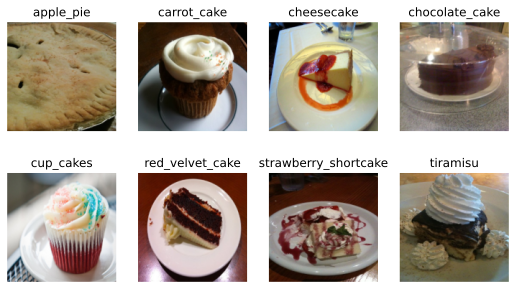

In [112]:
plt.figure(figsize=(9,5))
for i in range(8):
    plt.subplot(2,4,i+1)
    ind = i*100
    plt.imshow(imgdata[ind])    
    plt.title(classes[ind])
    plt.axis('off')
plt.show()

Next, store the images into a Tensor. ResNet assumes the data is [0,255] range, so we need to scale the images that were read in with skimage.

In [127]:
Xraw = zeros((len(imgdata), 224, 224, 3))
for i,img in enumerate(imgdata):
    x = image.img_to_array(img)*255   # preprocessing expects range [0,255]
    x = expand_dims(x, axis=0)
    Xraw[i,:] = x

Finally, we convert the class label strings into class numbers.

In [114]:
# convert class strings into integers
print("class labels (strings):", unique(classes))
le = preprocessing.LabelEncoder()
Y = le.fit_transform(classes)
print("Converted labels:")
print(Y)
Yb = keras.utils.to_categorical(Y)

class labels (strings): ['apple_pie' 'carrot_cake' 'cheesecake' 'chocolate_cake' 'cup_cakes'
 'red_velvet_cake' 'strawberry_shortcake' 'tiramisu']
Converted labels:
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2
 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2
 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2
 2 2 2 2 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3
 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3
 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 4 4 4 4 4 4 4
 4 4 4 4 4

## Extract Deep features
Now preprocess the images in imdata and put them into a 4D tensor for ResNet.  Store it in a tensor `Xim`.  
Note that `preprocess_input` will overwrite its input data, so you may need to make a `copy` if you want to preserve `Xraw`.

In [115]:
### INSERT YOUR CODE HERE ###
import tensorflow.keras.applications.resnet50 as resnet
from tensorflow.keras.preprocessing import image


In [116]:
Xim = copy(Xraw) # make a copy to avoid overwriting
Xim = resnet.preprocess_input(Xim)


print(shape(Xim)) # (800,224,224,3)
print(shape(Yb)) # (800,8), 8 categories, one-hot encoding


(800, 224, 224, 3)
(800, 8)


Extract features from Resnet50, call it `Xf`.

In [117]:
# create an instance of the model w/o the last layer
model_f = resnet.ResNet50(weights='imagenet', 
                          include_top=False,  # remove the classification layer
                          pooling='avg')      # apply GlobalAveragePooling

# compute the features
Xf = model_f.predict(Xim)

25/25 [==============================] - 2s 47ms/step


In [118]:
print(shape(Xf)) # (800,2048)

(800, 2048)


##  Train a classifier
Split the data into training and testing for the classifier.

In [119]:
# randomly split data into train and test set
( trainXf, testXf,       # features 
  trainY, testY,         # class labels
  trainYb, testYb,       # class one-hot vectors
  trainXim, testXim,     # processed images
  trainimgdata, testimgdata,     # raw images
) = \
  model_selection.train_test_split(Xf, Y, Yb, Xim, imgdata,
  train_size=0.8, test_size=0.2, random_state=4487)

print(trainXf.shape)
print(testXf.shape)

# cleanup memory
del trainimgdata, Xraw

(640, 2048)
(160, 2048)


Now train a few traditional classifier (e.g, SVM, logistic regression, random forest, etc.) and compute the accuracy.

In [ ]:
### INSERT YOUR CODE HERE ###

### 1. SVM

In [49]:
# Support Vector Machine

# setup the list of parameters to try
paramgrid = {'C': logspace(-3,3,13), 
             'gamma':[1e-10,0.0001,0.001,0.01,0.1,1]}

# setup cross-validation
svmcv = model_selection.GridSearchCV(svm.SVC(kernel='linear'), paramgrid, cv=5, n_jobs=-1, verbose=True)

# run cross-validation (train for each split)
svmcv.fit(trainXf, trainY)
svm_predY = svmcv.predict(testXf)
svm_acc = metrics.accuracy_score(testY, svm_predY)
print("[SVM] best test accuracy = ", svm_acc)

Fitting 5 folds for each of 78 candidates, totalling 390 fits
[SVM] best test accuracy =  0.6375


### 2.Random Forest

In [45]:
paramgrid_rf = {'n_estimators':[5, 10, 50, 100, 500, 1000]}
rf_cv = model_selection.GridSearchCV(ensemble.RandomForestClassifier(),
                                     param_grid=paramgrid_rf,
                                     cv=5,n_jobs=-1, verbose=True)
rf_cv.fit(trainXf, trainY)
rf_predY = rf_cv.predict(testXf)
rf_acc = metrics.accuracy_score(testY, rf_predY)
print("[RF] best test accuracy = ", rf_acc)

Fitting 5 folds for each of 6 candidates, totalling 30 fits
[RF] best test accuracy =  0.6125


### 3. Logistic Regression


In [47]:
paramgrid = {'C': logspace(-4,4,10)}

lr_cv = model_selection.GridSearchCV(linear_model.LogisticRegression(),
                                     paramgrid, cv=3, n_jobs=-1)

lr_cv.fit(trainXf, trainY)
lr_predY = lr_cv.predict(testXf)
lr_acc = metrics.accuracy_score(testY, lr_predY)
print("[RF] best test accuracy = ", lr_acc)

[RF] best test accuracy =  0.64375


c:\Users\yyz\Desktop\CS5489-机器学习\T 8\.conda\lib\site-packages\sklearn\linear_model\_logistic.py:460: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


## Analyze results

Run the below code to visualize the predictions on the test set.  `mypred` are the class predictions from your classifier.

In [55]:
for predY in [svm_predY,rf_predY,lr_predY]:
    mypred = predY

    # get the class labels
    predYcl = le.inverse_transform(mypred)
    testYcl = le.inverse_transform(testY)

    plt.figure(figsize=(15,60))
    px = 8
    py = int(ceil(len(predYcl)/5))
    for i in range(len(predYcl)):
        plt.subplot(py,px,i+1)
        mytitle = predYcl[i] + "\n(" + testYcl[i] + ")" 
        plt.imshow(testimgdata[i], interpolation='nearest')
        plt.title(mytitle, size=8)
        plt.gca().set_axis_off()

Now look at the confusion matrix

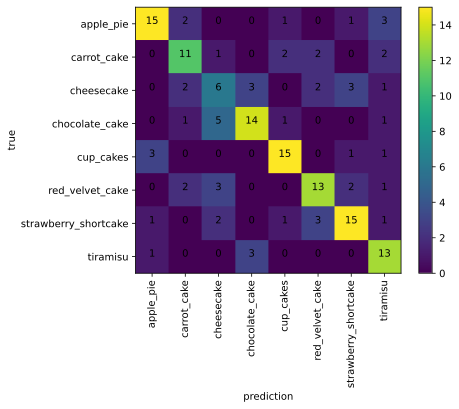

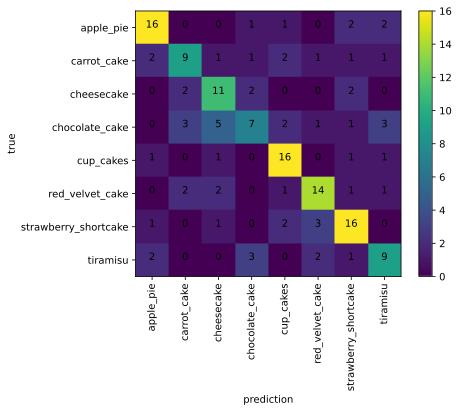

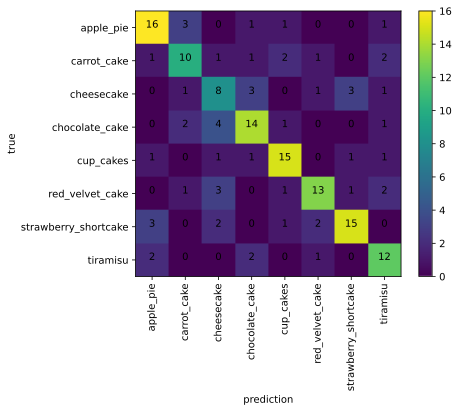

In [57]:
for predY in [svm_predY,rf_predY,lr_predY]:
    mypred = predY
    CM = metrics.confusion_matrix(testY, mypred)
    plt.figure()

    plt.imshow(CM, interpolation='nearest')
    plt.colorbar()

    tick_marks = arange(len(le.classes_))
    plt.xticks(tick_marks, le.classes_, rotation=90)
    plt.yticks(tick_marks, le.classes_)
    plt.xlabel('prediction')
    plt.ylabel('true')
    for i in range(len(le.classes_)):
        for j in range(len(le.classes_)):
            plt.text(j,i,"{}".format(CM[i,j]), horizontalalignment='center')

_How does the classifier make errors?_
- According to the results, the accuracy of these classifiers are between 0.61 and 0.64, which is not a very good result. 
- They all recognize apple pie, cup cakes and strawberry shortcake very well; 
- They all recognize carrotcake, cheesecake, and chocolate cake poorly and all confuse them with each other.
- For Random Forest, it can not well recognize tiramisu.

# Transfer learning

Try using a pre-trained network as the backbone for a new network. You can try some of the following:
- training an MLP classifier using the 2048 features from ResNet.
- using other networks (e.g., InceptionNet) to extract the features.
  - remember to change the pre-processing step too.
- using the a feature map (7x7x2048) and applying a small CNN.
- fine-tuning the whole network.

### 1. training an MLP classifier using the 2048 features from ResNet

In [21]:
def plot_history(history): 
    fig, ax1 = plt.subplots()
    
    ax1.plot(history.history['loss'], 'r', label="training loss ({:.6f})".format(history.history['loss'][-1]))
    ax1.plot(history.history['val_loss'], 'r--', label="validation loss ({:.6f})".format(history.history['val_loss'][-1]))
    ax1.grid(True)
    ax1.set_xlabel('iteration')
    ax1.legend(loc="best", fontsize=9)    
    ax1.set_ylabel('loss', color='r')
    ax1.tick_params('y', colors='r')

    
    if 'accuracy' in history.history:
        ax2 = ax1.twinx()

        ax2.plot(history.history['accuracy'], 'b', label="training acc ({:.4f})".format(history.history['accuracy'][-1]))
        ax2.plot(history.history['val_accuracy'], 'b--', label="validation acc ({:.4f})".format(history.history['val_accuracy'][-1]))

        ax2.legend(loc="best", fontsize=9)
        ax2.set_ylabel('acc', color='b')        
        ax2.tick_params('y', colors='b')
        

In [123]:
# generate a fixed validation set using 10% of the training set
vtrainXim, validXim, vtrainYb, validYb = \
  model_selection.train_test_split(trainXim, trainYb, 
  train_size=0.9, test_size=0.1, random_state=6487)

# validation data
validset  = (validXim, validYb)

In [33]:
def add_gauss_noise(X, sigma2=0.05):  #0.05
    # add Gaussian noise with zero mean, and variance sigma2
    return X + random.normal(0, sigma2, X.shape)

# build the data augmenter
datagen = ImageDataGenerator(
    rotation_range=10,         # image rotation
    width_shift_range=0.1,     # image shifting
    height_shift_range=0.1,    # image shifting
    shear_range=0.1,           # shear transformation
    zoom_range=0.1,            # zooming
    horizontal_flip=True, 
    preprocessing_function=add_gauss_noise, 
)

# fit (required for some normalization augmentations)
datagen.fit(vtrainXim)

In [25]:
# setup early stopping callback function
earlystop = keras.callbacks.EarlyStopping(
    monitor='val_loss',     # look at the validation loss
    min_delta=0.0001,       # threshold to consider as no change
    patience=5,             # stop if 5 epochs with no change
    verbose=1, mode='auto'
)
callbacks_list = [earlystop]

In [56]:
# train the model on the new data for a few epochs
bsize = 32
callbacks_list = []

base_model = resnet.ResNet50(weights='imagenet', include_top=False, pooling='avg')


x = base_model.output
x = Dense(128, activation='relu')(x)
x = Dense(64, activation='relu')(x)
x = Dense(32, activation='relu')(x)
x = Dropout(0.2)(x)
predictions = Dense(8, activation='softmax')(x)

model_ft = Model(inputs=base_model.input, outputs=predictions)

for layer in base_model.layers:
    layer.trainable = False

model_ft.compile(optimizer='rmsprop',  
              loss='categorical_crossentropy', metrics=['accuracy'])

In [57]:
import scipy
print(shape(vtrainXim))
print(shape(vtrainYb))

(576, 224, 224, 3)
(576, 8)


In [62]:
history = model_ft.fit(
            datagen.flow(vtrainXim, vtrainYb, batch_size=bsize),  # data from generator
            steps_per_epoch=len(vtrainXim)/bsize,    # should be number of batches per epoch
            epochs=30,
            callbacks=callbacks_list, 
            validation_data=validset, verbose=True)

Epoch 1/30
18/18 [==============================] - 4s 228ms/step - loss: 0.3236 - accuracy: 0.8837 - val_loss: 1.6941 - val_accuracy: 0.6250
Epoch 2/30
18/18 [==============================] - 4s 236ms/step - loss: 0.2306 - accuracy: 0.9253 - val_loss: 1.3664 - val_accuracy: 0.6875
Epoch 3/30
18/18 [==============================] - 4s 238ms/step - loss: 0.2397 - accuracy: 0.9201 - val_loss: 1.4450 - val_accuracy: 0.6562
Epoch 4/30
18/18 [==============================] - 4s 234ms/step - loss: 0.2421 - accuracy: 0.9115 - val_loss: 1.4298 - val_accuracy: 0.6250
Epoch 5/30
18/18 [==============================] - 4s 233ms/step - loss: 0.1335 - accuracy: 0.9705 - val_loss: 1.4896 - val_accuracy: 0.6562
Epoch 6/30
18/18 [==============================] - 4s 240ms/step - loss: 0.2738 - accuracy: 0.9201 - val_loss: 1.3797 - val_accuracy: 0.6250
Epoch 7/30
18/18 [==============================] - 4s 237ms/step - loss: 0.1291 - accuracy: 0.9670 - val_loss: 1.7104 - val_accuracy: 0.6250
Epoch 

test accuracy: 0.6125


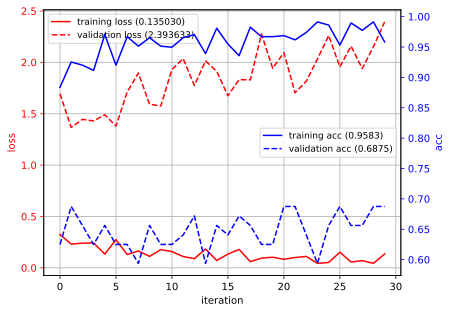

In [63]:
plot_history(history)
predY = argmax(model_ft.predict(testXim, verbose=False), axis=-1)
acc = metrics.accuracy_score(testY, predY)
print("test accuracy:", acc)

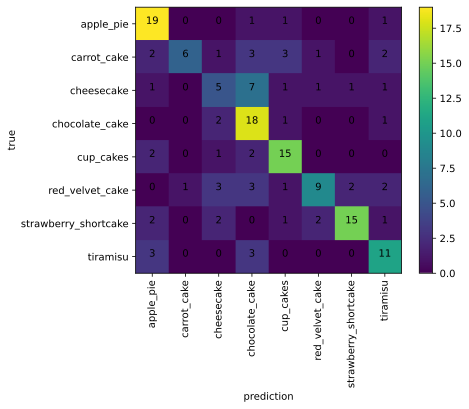

In [64]:
mypred = predY
CM = metrics.confusion_matrix(testY, mypred)
plt.figure()

plt.imshow(CM, interpolation='nearest')
plt.colorbar()

tick_marks = arange(len(le.classes_))
plt.xticks(tick_marks, le.classes_, rotation=90)
plt.yticks(tick_marks, le.classes_)
plt.xlabel('prediction')
plt.ylabel('true')
for i in range(len(le.classes_)):
    for j in range(len(le.classes_)):
        plt.text(j,i,"{}".format(CM[i,j]), horizontalalignment='center')

### 2.using other networks (e.g., InceptionNet) to extract the features.


In [129]:
from keras.applications import inception_v3

K.clear_session()

Xim_inception = zeros((len(imgdata), 224, 224, 3))

for i in range(len(imgdata)):
    xi = Xraw[i,:,:,:]
    xi = inception_v3.preprocess_input(xi) # to use inception
    Xim_inception[i,:] = xi
print(Xim_inception.shape)

(trainY, testY,         # class labels
  trainYb, testYb,       # class one-hot vectors
  trainXim_new, testXim_new,     # processed images
  trainimgdata, testimgdata,     # raw images
) = \
  model_selection.train_test_split(Y, Yb, Xim_inception, imgdata,
  train_size=0.8, test_size=0.2, random_state=4487)

# split into training and validation sets
vtrainXim_new, validXim_new, vtrainYb, validYb = \
model_selection.train_test_split(trainXim_new, trainYb,
train_size=0.9, test_size=0.1, random_state=6487)

validset_new = (validXim_new, validYb)


(800, 224, 224, 3)


In [130]:
base_model = inception_v3.InceptionV3(weights='imagenet', include_top=False, pooling='avg')

x = base_model.output
x = Dense(64, activation='relu')(x)
x = Dense(48, activation='relu')(x)
x = Dropout(0.3)(x)
predictions = Dense(8, activation='softmax')(x)

model_inc = Model(inputs=base_model.input, outputs=predictions)

for layer in base_model.layers:
    layer.trainable = False

model_inc.compile(optimizer='adam',  
              loss='categorical_crossentropy', metrics=['accuracy'])

In [131]:
history_inc = model_inc.fit(
            datagen.flow(vtrainXim, vtrainYb, batch_size=bsize),  # data from generator
            steps_per_epoch=len(vtrainXim)/bsize,    # should be number of batches per epoch
            epochs=30,
            callbacks=callbacks_list, 
            validation_data=validset, verbose=True)

Epoch 1/30
18/18 [==============================] - 8s 319ms/step - loss: 15.6708 - accuracy: 0.1424 - val_loss: 4.7223 - val_accuracy: 0.1562
Epoch 2/30
18/18 [==============================] - 5s 258ms/step - loss: 4.5583 - accuracy: 0.1215 - val_loss: 2.6368 - val_accuracy: 0.2188
Epoch 3/30
18/18 [==============================] - 4s 246ms/step - loss: 2.3681 - accuracy: 0.1510 - val_loss: 2.1796 - val_accuracy: 0.0625
Epoch 4/30
18/18 [==============================] - 5s 256ms/step - loss: 2.1008 - accuracy: 0.1354 - val_loss: 2.0750 - val_accuracy: 0.0625
Epoch 5/30
18/18 [==============================] - 4s 248ms/step - loss: 2.0783 - accuracy: 0.1233 - val_loss: 2.0743 - val_accuracy: 0.0625
Epoch 6/30
18/18 [==============================] - 5s 252ms/step - loss: 2.0823 - accuracy: 0.1267 - val_loss: 2.0742 - val_accuracy: 0.0781
Epoch 7/30
18/18 [==============================] - 5s 252ms/step - loss: 2.0735 - accuracy: 0.1302 - val_loss: 2.0773 - val_accuracy: 0.0781
Epoch

test accuracy: 0.10625


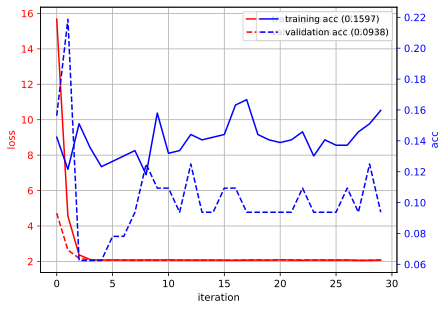

In [132]:
plot_history(history_inc)
predY = argmax(model_inc.predict(testXim, verbose=False), axis=-1)
acc = metrics.accuracy_score(testY, predY)
print("test accuracy:", acc)

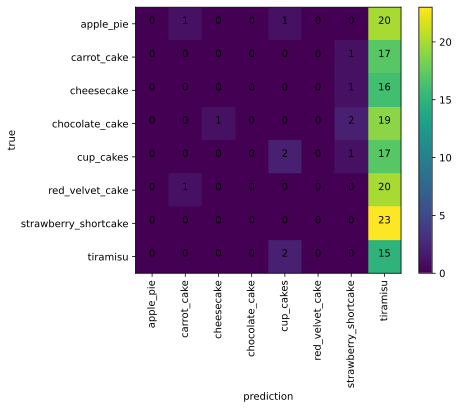

In [133]:
mypred = predY
CM = metrics.confusion_matrix(testY, mypred)
plt.figure()

plt.imshow(CM, interpolation='nearest')
plt.colorbar()

tick_marks = arange(len(le.classes_))
plt.xticks(tick_marks, le.classes_, rotation=90)
plt.yticks(tick_marks, le.classes_)
plt.xlabel('prediction')
plt.ylabel('true')
for i in range(len(le.classes_)):
    for j in range(len(le.classes_)):
        plt.text(j,i,"{}".format(CM[i,j]), horizontalalignment='center')

### 3.Using the a feature map (7x7x2048) and applying a small CNN.

In [86]:
model_resnet = resnet.ResNet50(weights='imagenet', include_top=False)

Xf_new = model_resnet.predict(Xim, verbose=False)

print(Xf_new.shape)

(800, 7, 7, 2048)


In [87]:
# randomly split data into train and test set
( trainXf_new, testXf_new,       # features 
  trainY, testY,         # class labels
  trainYb, testYb       # class one-hot vectors
) = \
  model_selection.train_test_split(Xf_new, Y, Yb,
  train_size=0.8, test_size=0.2, random_state=4487)

# generate a fixed validation set using 10% of the training set
vtrainf_new, validf_new, vtrainYb, validYb = \
  model_selection.train_test_split(trainXf_new, trainYb, 
  train_size=0.9, test_size=0.1, random_state=6487)

# validation data
validset  = (validf_new, validYb)

In [102]:
def cnn_2(learning_rate, momentum):
    nn = Sequential()
    nn.add(Conv2D(32, (5,5), strides=(2,2), activation='relu', padding='same', input_shape=(7,7,2048)))
    nn.add(BatchNormalization())
    nn.add(Conv2D(64, (5,5), strides=(2,2), activation='relu', padding='same'))
    nn.add(BatchNormalization())
    nn.add(Dropout(0.3))
    nn.add(Flatten())
    nn.add(Dense(units=64, activation='relu'))
    nn.add(Dense(units=32, activation='relu'))
    nn.add(Dense(units=8, activation='softmax'))

    optimizer = keras.optimizers.SGD(learning_rate=learning_rate, momentum=momentum, nesterov=True)
    nn.compile(loss=keras.losses.categorical_crossentropy, optimizer=optimizer, metrics=['accuracy'])
    return nn

nn = cnn_2(0.1, 0.7)

history_cnn = nn.fit(trainXf_new, trainYb, validation_data = validset, callbacks=callbacks_list, epochs=50, batch_size=32)

Epoch 1/50
20/20 [==============================] - 1s 13ms/step - loss: 2.0567 - accuracy: 0.1937 - val_loss: 2.6241 - val_accuracy: 0.2344
Epoch 2/50
20/20 [==============================] - 0s 9ms/step - loss: 1.6904 - accuracy: 0.3422 - val_loss: 1.5538 - val_accuracy: 0.3594
Epoch 3/50
20/20 [==============================] - 0s 8ms/step - loss: 1.3393 - accuracy: 0.5094 - val_loss: 1.4929 - val_accuracy: 0.5000
Epoch 4/50
20/20 [==============================] - 0s 8ms/step - loss: 1.0242 - accuracy: 0.5891 - val_loss: 0.7437 - val_accuracy: 0.6875
Epoch 5/50
20/20 [==============================] - 0s 8ms/step - loss: 0.8122 - accuracy: 0.7000 - val_loss: 0.5663 - val_accuracy: 0.7500
Epoch 6/50
20/20 [==============================] - 0s 8ms/step - loss: 0.5300 - accuracy: 0.8172 - val_loss: 0.6403 - val_accuracy: 0.7656
Epoch 7/50
20/20 [==============================] - 0s 8ms/step - loss: 0.3793 - accuracy: 0.8781 - val_loss: 0.3368 - val_accuracy: 0.8750
Epoch 8/50
20/20 [=

test accuracy: 0.6125


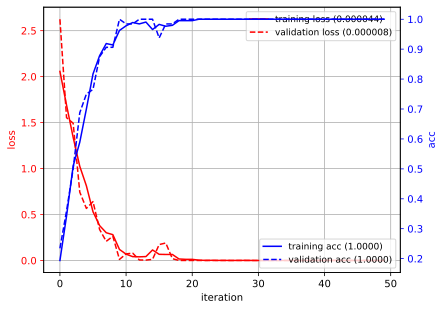

In [103]:
plot_history(history_cnn)
predY = argmax(nn.predict(testXf_new, verbose=False), axis=-1)
acc = metrics.accuracy_score(testY, predY)
print("test accuracy:", acc)

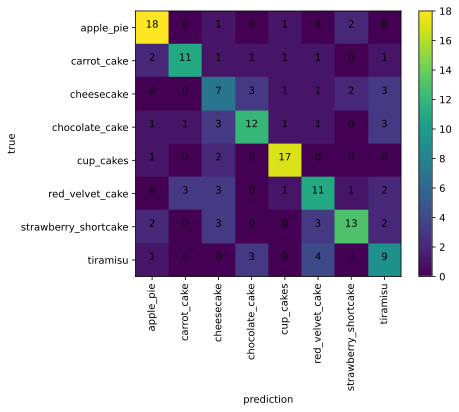

In [104]:
mypred = predY
CM = metrics.confusion_matrix(testY, mypred)
plt.figure()

plt.imshow(CM, interpolation='nearest')
plt.colorbar()

tick_marks = arange(len(le.classes_))
plt.xticks(tick_marks, le.classes_, rotation=90)
plt.yticks(tick_marks, le.classes_)
plt.xlabel('prediction')
plt.ylabel('true')
for i in range(len(le.classes_)):
    for j in range(len(le.classes_)):
        plt.text(j,i,"{}".format(CM[i,j]), horizontalalignment='center')

## Analysis
For your best deep learning model, visualize the result and analyze the errors.

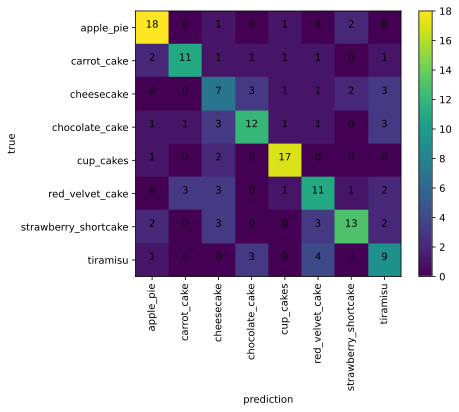

In [106]:
mypred = predY
CM = metrics.confusion_matrix(testY, mypred)
plt.figure()

plt.imshow(CM, interpolation='nearest')
plt.colorbar()

tick_marks = arange(len(le.classes_))
plt.xticks(tick_marks, le.classes_, rotation=90)
plt.yticks(tick_marks, le.classes_)
plt.xlabel('prediction')
plt.ylabel('true')
for i in range(len(le.classes_)):
    for j in range(len(le.classes_)):
        plt.text(j,i,"{}".format(CM[i,j]), horizontalalignment='center')

_Where you able to improve the accuracy using deep learning? Analyze the errors from your best model._
- In my experiments, my CNN and MLP obtained the same accuracy, both 0.6125. I have visualized the results for each classifier, and i found that both of them recognized apple pie and cup cakes very well, and both of them have failed to recognize cheesecake and tiramisu very well, which is the same as the previous traditional method classifiers.

- The results after deep learning are not as good as the previous traditional methods, and I think there is room for better tuning of the deep learning approach.

- In order to get a good result, I think adjusting the number of layers of the neural network, the size convolutional kernel, and the complexity of the architecture  might be a good idea. Also, maybe trying a new migration training method could lead to better results. It is also possible to try to find more suitable epoches and batch sizes. According to the previous results, InceptionNet resulted overfitting, which I think can be improved by adjusting the ratio of dropout, or adjusting the network architecture.